# Identify test images with issues

In [3]:
# Import helper functions from utils.py
import utils 
import glob
import numpy as np
import matplotlib.pyplot as plt

import cv2

In [4]:
test_path = glob.glob("../../data/SWED/test/images/*")
print(test_path[0])
print(len(test_path))

# Initialise data processing class
processor = utils.data_processor()

# Load all images and labels
input = []
rgb = []
labels = []

for path in test_path:
    try:
        img, rgb_img, label = processor.load_test(path)
    
        input.append(img)
        labels.append(label)
        rgb.append(rgb_img)
    except:
        print("Error with image: ", path)

# Apply canny edge detection to binary maps to get reference edges
canny_input = [np.uint8(img*255) for img in labels]
edge_reference = [np.uint8(cv2.Canny(img,threshold1 = 100, threshold2 = 200)) for img in canny_input]

../../data/SWED/test/images/S2A_MSIL2A_20191105T023901_N0213_R089_T50RPN_20191105T062756_image_0_0.tif
98


In [7]:
def plot_image(rint):
    # Sense check edge references
    fig, ax = plt.subplots(1,3, figsize=(20,20))
    fig.set_facecolor('white')

    ax[0].imshow(rgb[rint])
    ax[0].set_title('Image {}'.format(i),size=20)
    ax[1].imshow(1-labels[rint] ,  cmap='gray')
    ax[1].set_title('Ground Truth \nMask',size=20)
    ax[2].imshow(255-edge_reference[rint], cmap='gray')
    ax[2].set_title('Ground Truth \nEdge Map',size=20)

    for a in ax:
        a.set_xticks([])
        a.set_yticks([])

/var/folders/_j/wkrsnnnn2lj6cds3dhhlkkh40000gn/T/ipykernel_1625/1955266914.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,3, figsize=(20,20))


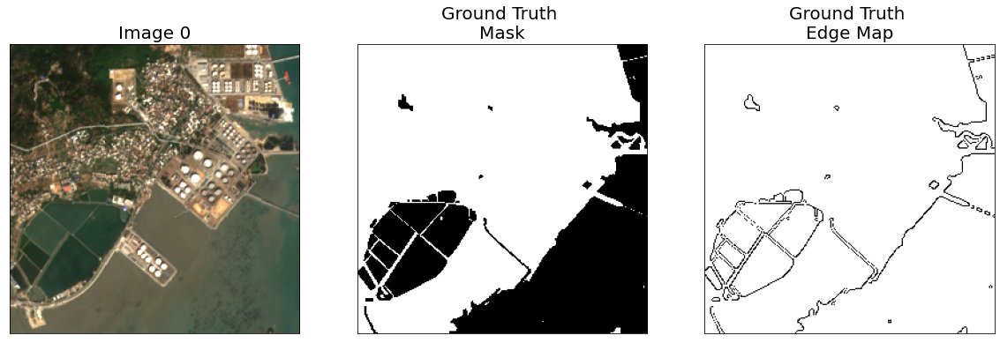

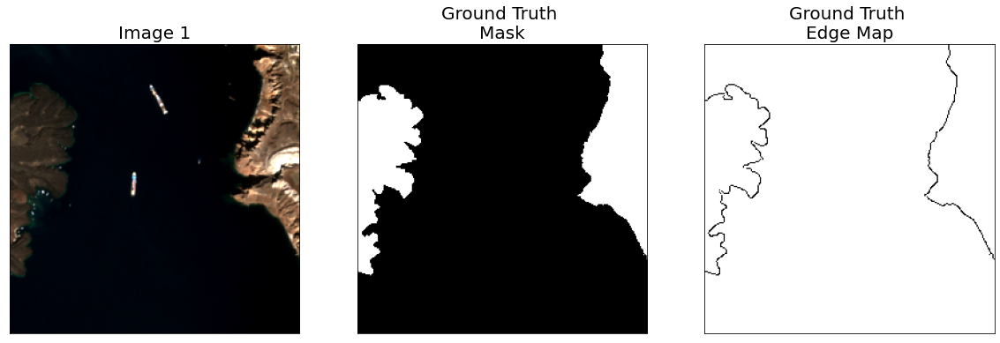

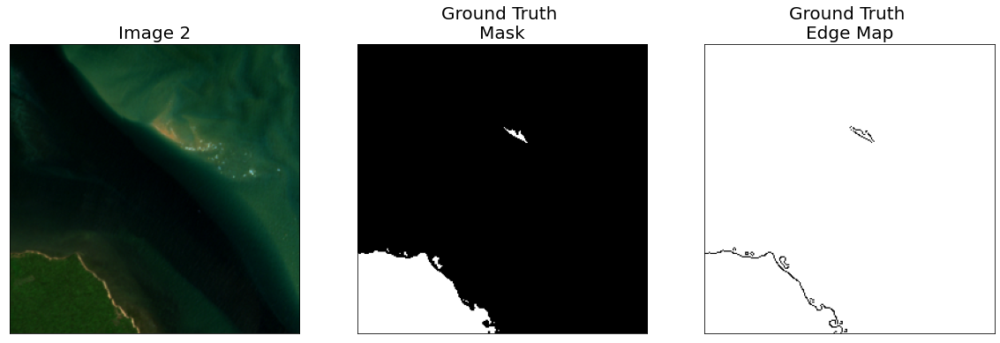

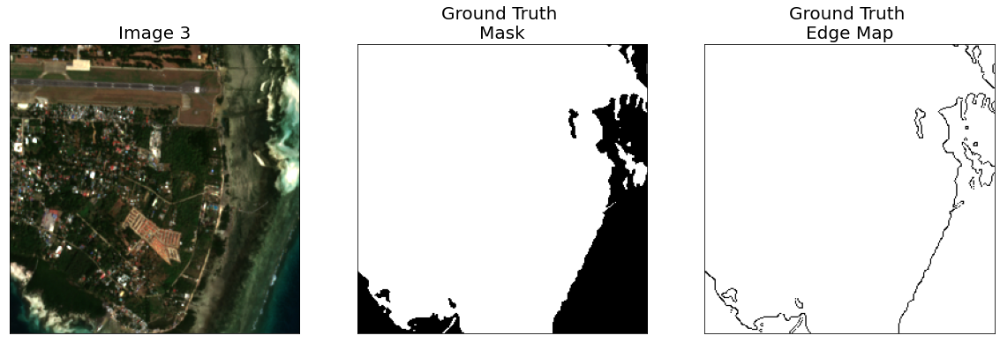

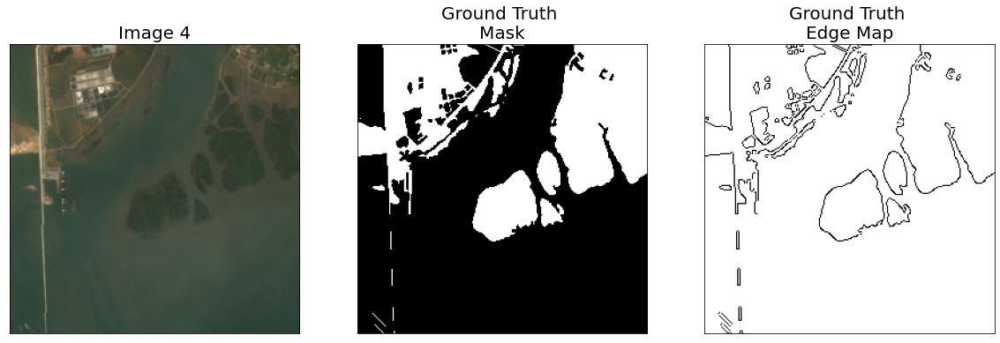

...

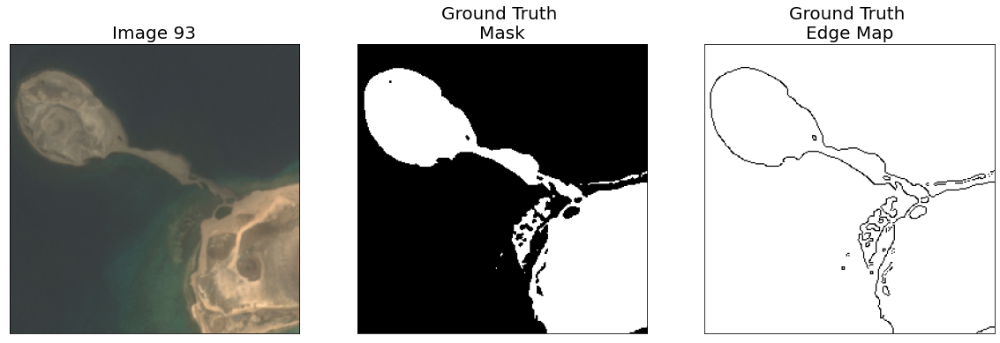

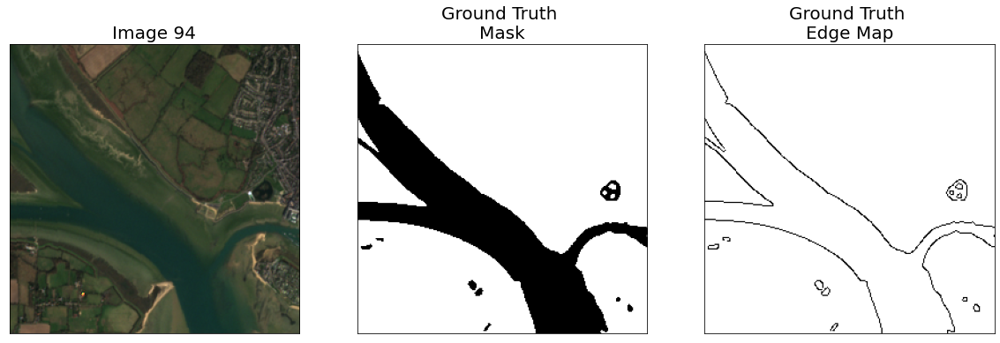

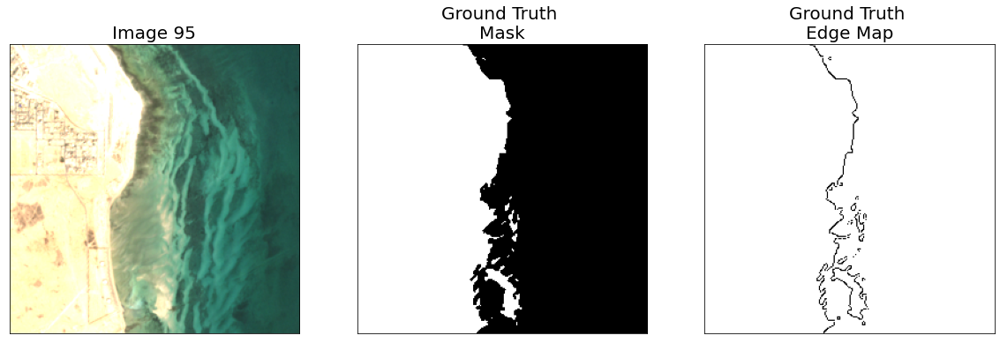

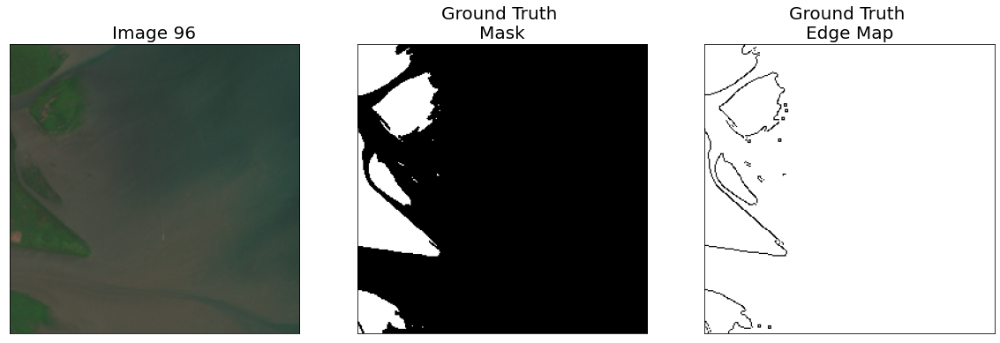

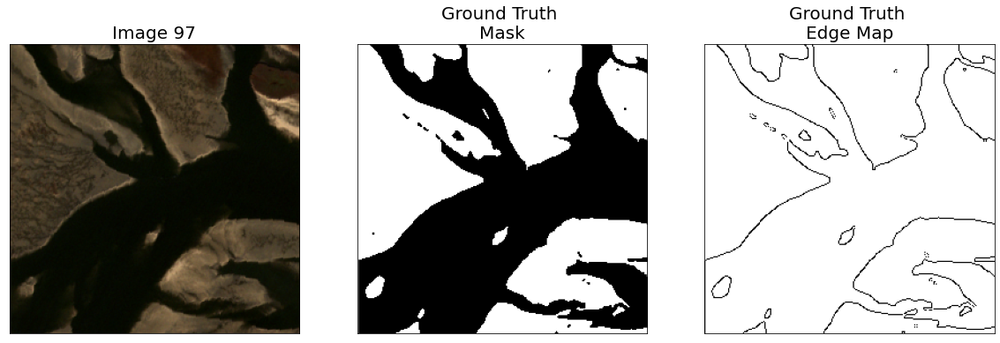

In [8]:
#Plot all images 
for i in range(len(test_path)):
    plot_image(i)


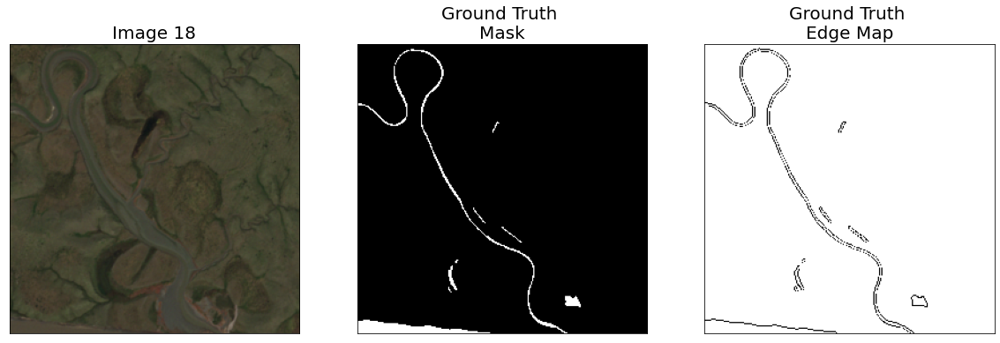

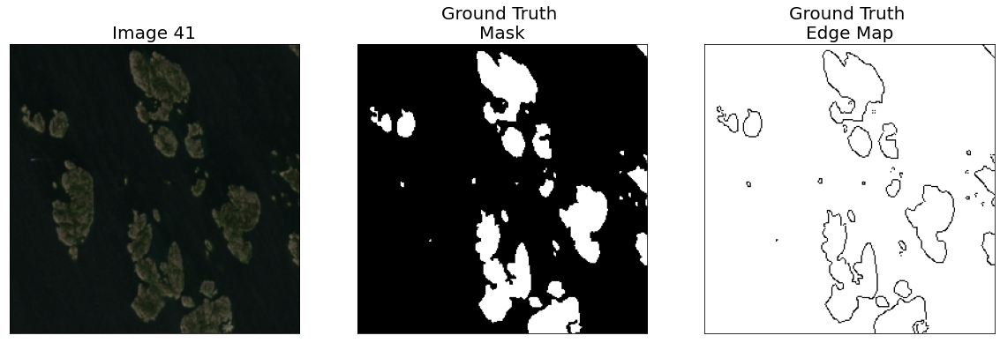

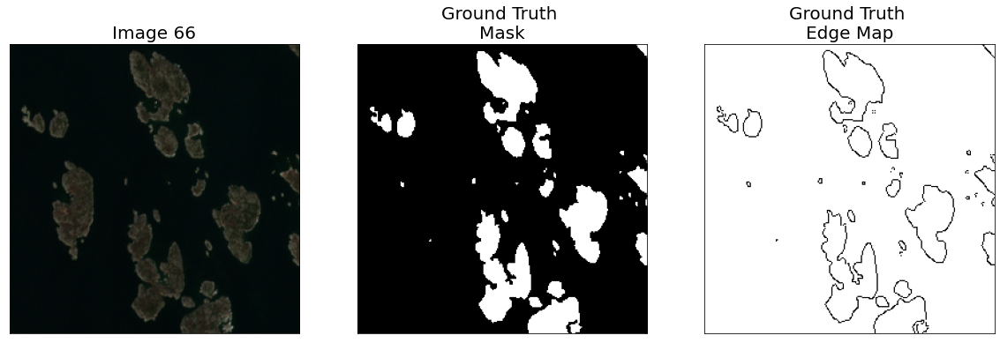

In [14]:
#Plot images with issues 
"""
Image 18 - label is swapped where land (1) and water (0)
Image 41, 66 - part of the land is not labelled 
"""
for i in [18,41,66]:
    plot_image(i)

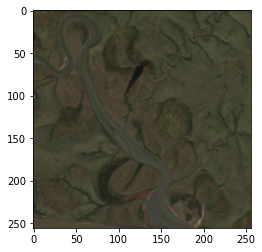

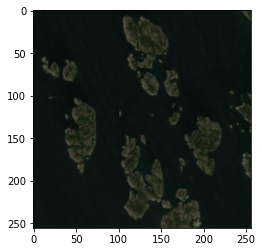

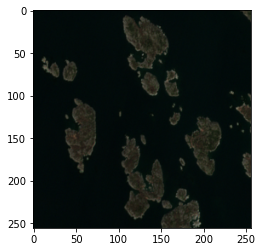

In [15]:
#Double check these are the correct images: 
paths = ["../../data/SWED/test/images/S2A_MSIL2A_20190803T025551_N0213_R032_T54XWG_20190803T043943_image_0_0.tif",
"../../data/SWED/test/images/S2A_MSIL2A_20190901T101031_N0213_R022_T34VDM_20190901T130348_image_0_0.tif",
"../../data/SWED/test/images/S2A_MSIL2A_20200405T100021_N0214_R122_T34VDM_20200405T115512_image_0_0.tif"]

for path in paths:
    img, rgb_img, label = processor.load_test(path)
    plt.imshow(rgb_img)
    plt.show()